# Warfarin Dosing Service Exploratory Analysis

*Brian Gulbis*  
*May 27, 2016*

In [1]:
library(BGTools)
library(dplyr)
library(tidyr)
library(stringr)
library(ggplot2)
library(scales)
library(tableone)


Attaching package: 'dplyr'

The following objects are masked from 'package:stats':

    filter, lag

The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union



In [2]:
tmp <- get_rds("tidy")
tmp <- get_rds("analysis")

## Warfarin Utilization

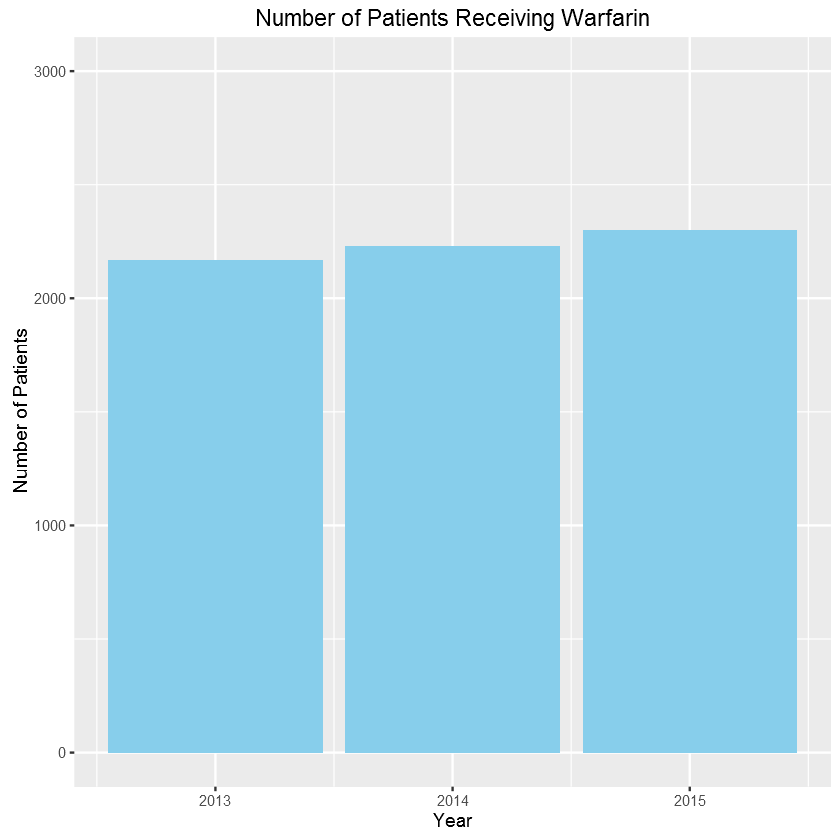

In [3]:
analyze.patients.all %>%
    filter(year.cal >= 2013) %>%
    ggplot(aes(x = year.cal)) +
    geom_bar(fill = "skyblue") +
    ggtitle("Number of Patients Receiving Warfarin") +
    xlab("Year") +
    ylab("Number of Patients") +
    scale_y_continuous(limits = c(0, 3000))

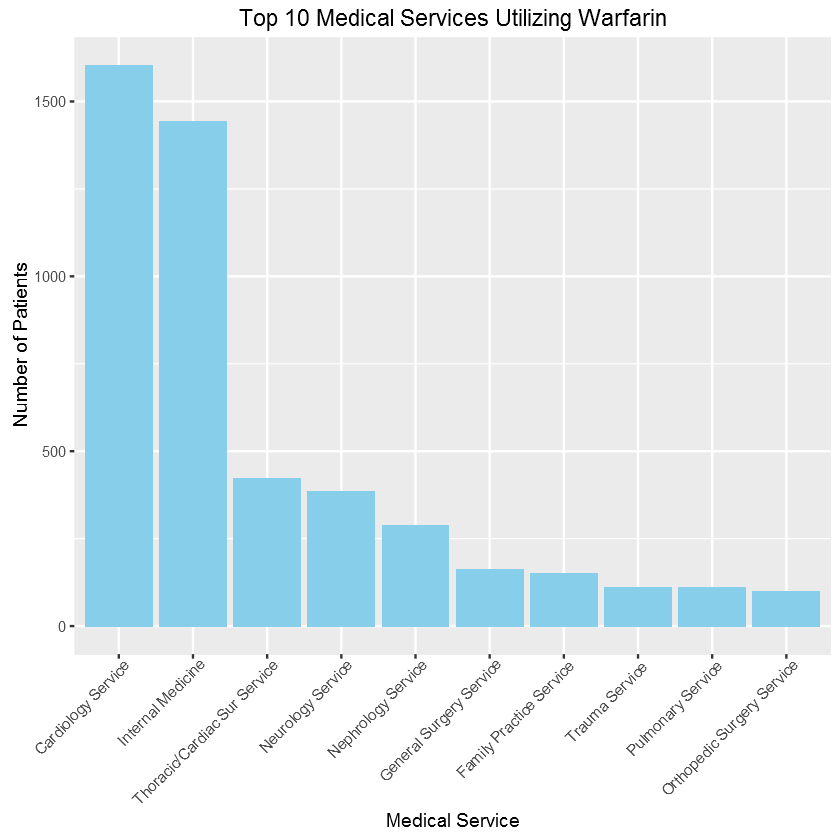

In [4]:
analyze.services.all %>%
    mutate(service = factor(service, levels = names(sort(table(service), decreasing = TRUE)), ordered = TRUE)) %>%
    group_by(service) %>%
    summarize(count = n()) %>%
    arrange(desc(count)) %>%
    top_n(10, count) %>%
    ggplot(aes(x = service, y = count)) +
    geom_bar(stat = "identity", fill = "skyblue") +
    ggtitle("Top 10 Medical Services Utilizing Warfarin") +
    xlab("Medical Service") +
    ylab("Number of Patients") +
    theme(axis.text.x = element_text(angle = 45, hjust = 1))

In [5]:
tmp <- analyze.services.all %>%
mutate(service = factor(service, levels = names(sort(table(service), decreasing = TRUE)), ordered = TRUE)) %>%
group_by(service, consult, historical) %>%
summarize(count = n()) %>%
arrange(desc(count)) %>%
filter(service <="Orthopedic Surgery Service") %>%
group_by(service, historical) %>%
spread(consult, count) %>%
mutate(`FALSE` = `FALSE` - `TRUE`)

tmp$`FALSE`[tmp$`FALSE` < 0] <- 0

tmp <- gather(tmp, consult, count, -service, -historical)

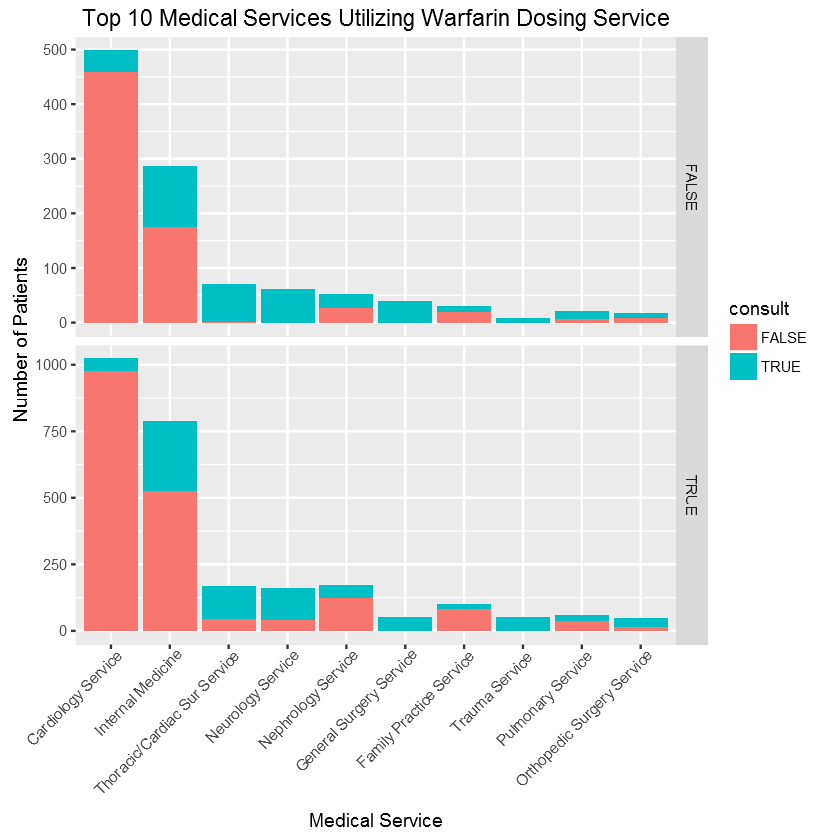

In [6]:
ggplot(data = tmp, aes(x = service, y = count, fill = consult)) +
geom_bar(stat = "identity") +
facet_grid(historical ~ ., scales = "free_y") +
ggtitle("Top 10 Medical Services Utilizing Warfarin Dosing Service") +
xlab("Medical Service") +
ylab("Number of Patients") +
theme(axis.text.x = element_text(angle = 45, hjust = 1))

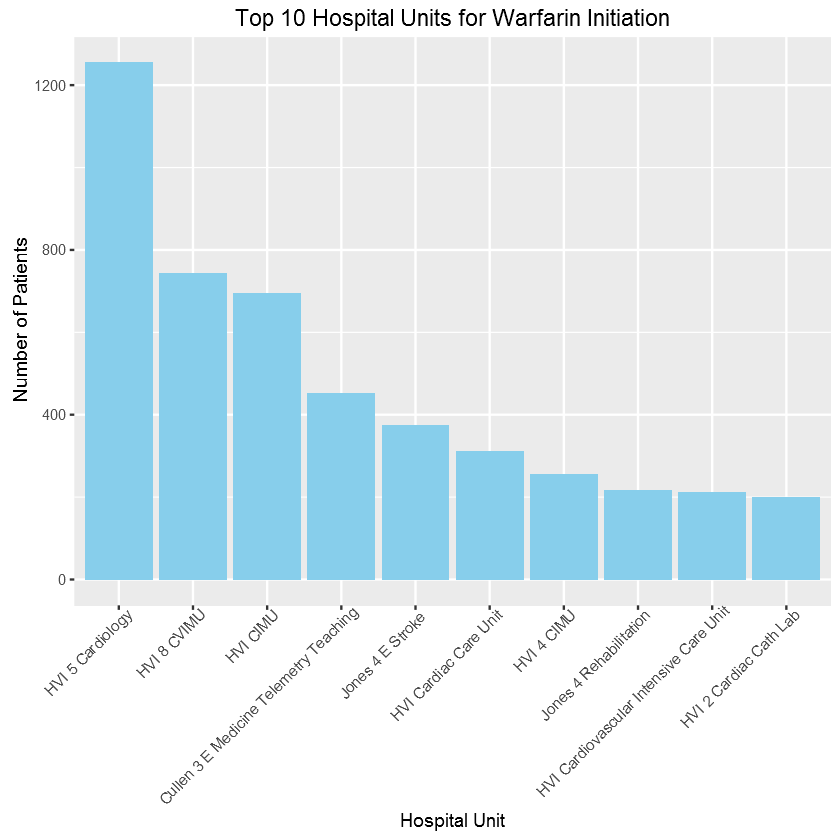

In [7]:
analyze.locations.all %>%
    mutate(location = factor(location, levels = names(sort(table(location), decreasing = TRUE)), ordered = TRUE)) %>%
    group_by(location) %>%
    summarize(count = n()) %>%
    arrange(desc(count)) %>%
    top_n(10, count) %>%
    ggplot(aes(x = location, y = count)) +
    geom_bar(stat = "identity", fill = "skyblue") +
    ggtitle("Top 10 Hospital Units for Warfarin Initiation") +
    xlab("Hospital Unit") +
    ylab("Number of Patients") +
    theme(axis.text.x = element_text(angle = 45, hjust = 1))

## Utilization of Dosing Service

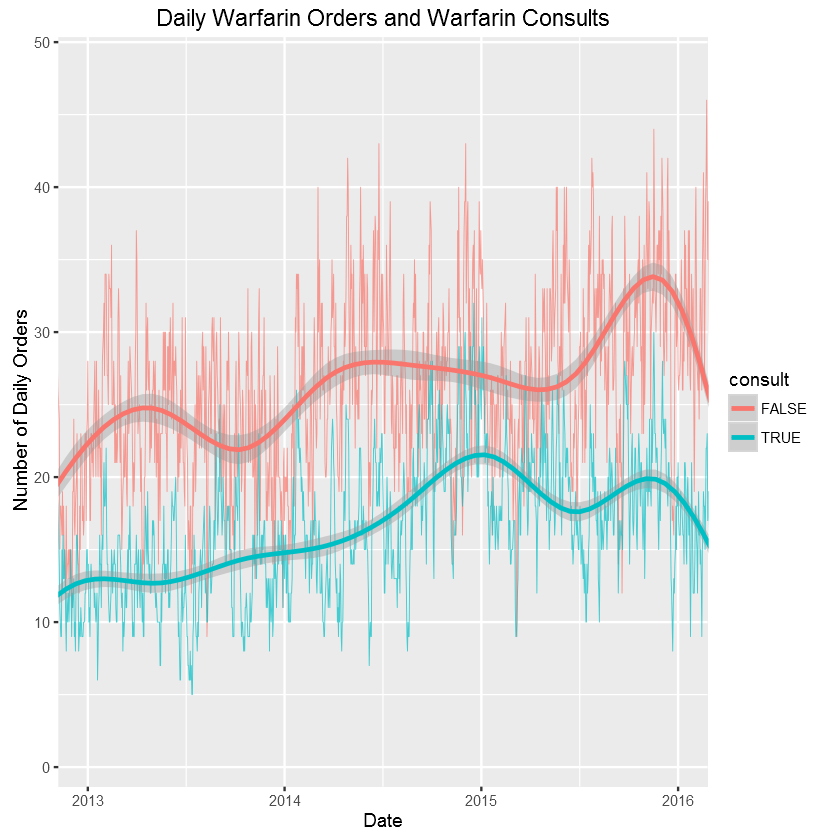

In [23]:
library(lubridate)
ggplot(data = analyze.utilization, aes(x = action.date, y = n, color = consult)) +
geom_line(size = 0.2, alpha = 0.7) +
geom_smooth() + 
# geom_smooth(method = "lm", linetype = "dashed") +
ggtitle("Daily Warfarin Orders and Warfarin Consults") +
xlab("Date") + 
ylab("Number of Daily Orders") +
# xlim(c(mdy_hm("1/1/2013 00:00"), mdy_hm("12/31/2015 23:59"))) 
coord_cartesian(xlim = c(mdy_hm("1/1/2013 00:00"), mdy_hm("12/31/2015 23:59"))) 

Warning message:
: Removed 17 rows containing non-finite values (stat_smooth).Warning message:
: Removed 17 rows containing non-finite values (stat_smooth).Warning message:
: Removed 16 rows containing missing values (geom_path).

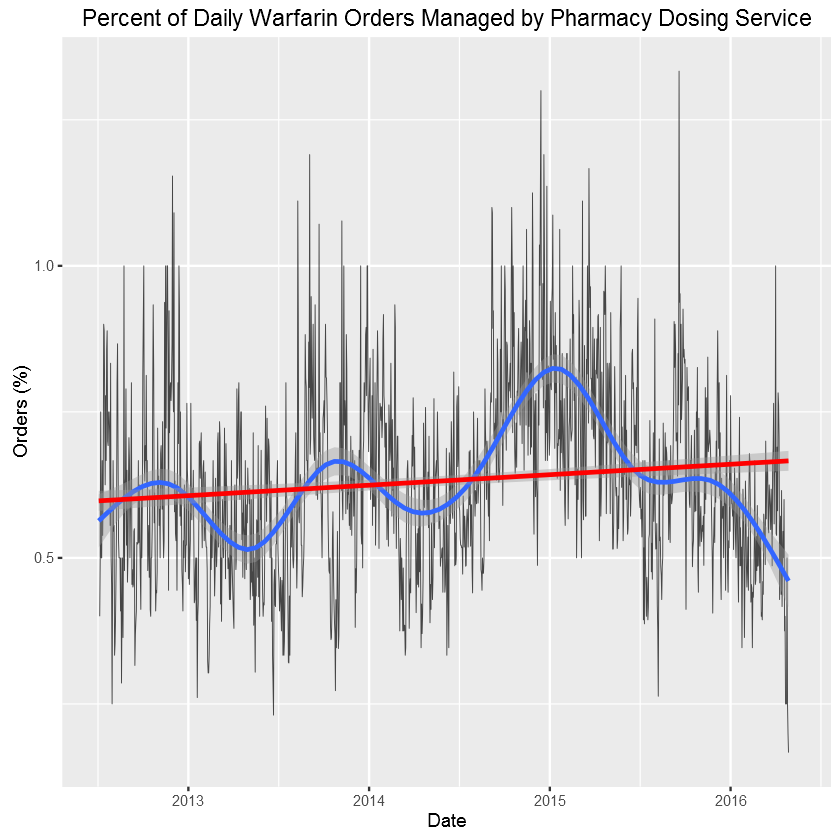

In [9]:
group_by(analyze.utilization, action.date) %>%
spread(consult, n) %>%
rename(warfarin = `FALSE`, consults = `TRUE`) %>%
mutate(perc.consults = consults / warfarin) %>%
ggplot(aes(x = action.date, y = perc.consults)) +
geom_line(size = 0.2, alpha = 0.7) +
geom_smooth() +
geom_smooth(method = "lm", color = "red") +
ggtitle("Percent of Daily Warfarin Orders Managed by Pharmacy Dosing Service") +
xlab("Date") +
ylab("Orders (%)")

## Comparison

### Groups

* Current: warfarin started between January 1, 2015 and December 31, 2015
* Historical: warfarin started between July 1, 2012 and December 31, 2014

In [10]:
total <- pts.include %>%
    group_by(group, year) %>%
    summarize(total = n())

groups <- total %>%
    spread(year, total)

groups

,group,current,historical
1,pharmacy,402,866
2,traditional,287,894


### Demographics

#### Current Year

In [11]:
demograph <- pts.include %>% 
    inner_join(data.demographics, by = "pie.id") %>%
    mutate(sex = factor(sex, levels = c("Female", "Male")),
           race = str_replace_all(race, "Oriental", "Asian"),
           race = factor(race, exclude = c("", "Unknown")))

vars <- c("age", "sex", "race", "length.stay")
fvars <- c("sex", "race")
d <- filter(demograph, year == "current")
tbl <- CreateTableOne(vars, "group", d, fvars)
tbl <- print(tbl, nonnormal = c("age", "length.stay"), printToggle = FALSE)

tbl

,pharmacy,traditional,p,test
n,402,287,,
age (median [IQR]),"58.00 [42.25, 68.75]","64.00 [54.00, 72.00]",<0.001,nonnorm
sex = Male (%),240 (59.7),183 (64.0),0.290,
race (%),,,0.093,
African American,104 (28.4),74 (27.7),,
Asian,12 ( 3.3),1 ( 0.4),,
Native Am.,0 ( 0.0),1 ( 0.4),,
Other,78 (21.3),59 (22.1),,
White/Caucasian,172 (47.0),132 (49.4),,
length.stay (median [IQR]),"12.10 [7.71, 19.83]","13.71 [8.02, 24.12]",0.110,nonnorm


#### Historical Years

In [12]:
d <- filter(demograph, year == "historical")
tbl <- CreateTableOne(vars, "group", d, fvars)
tbl <- print(tbl, nonnormal = c("age", "length.stay"), printToggle = FALSE)
tbl

,pharmacy,traditional,p,test
n,866,894,,
age (median [IQR]),"59.00 [46.00, 71.00]","62.00 [51.00, 73.00]",<0.001,nonnorm
sex = Male (%),505 (58.3),526 (58.9),0.840,
race (%),,,0.434,
African American,245 (31.2),228 (28.1),,
Asian,15 ( 1.9),13 ( 1.6),,
Latin American,1 ( 0.1),0 ( 0.0),,
Native Am.,0 ( 0.0),1 ( 0.1),,
Other,133 (16.9),131 (16.2),,
White/Caucasian,392 (49.9),437 (54.0),,


### Indications

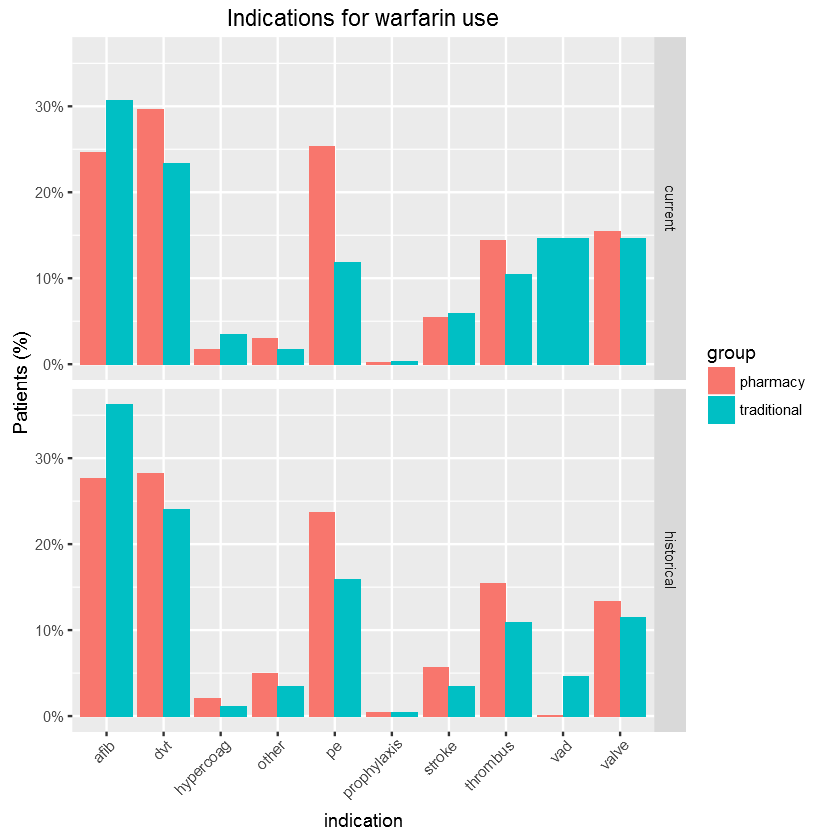

In [13]:
counts <- pts.include %>%
    inner_join(data.warfarin.indications, by = "pie.id") %>%
    gather(indication, value, -pie.id, -group, -year) %>%
    filter(value == TRUE) %>%
    group_by(group, year, indication) %>%
    summarize(n = n()) %>%
    left_join(total, by = c("group", "year")) %>%
    mutate(perc = n / total) 

ggplot(data = counts, aes(x = indication, fill = group)) +
    geom_bar(aes(y = perc), stat = "identity", position = "dodge") + 
    facet_grid(year ~ .) +
    ggtitle("Indications for warfarin use") +
    ylab("Patients (%)") +
    scale_y_continuous(labels = percent) +
    theme(axis.text.x = element_text(angle = 45, hjust = 1))

### Dispositions

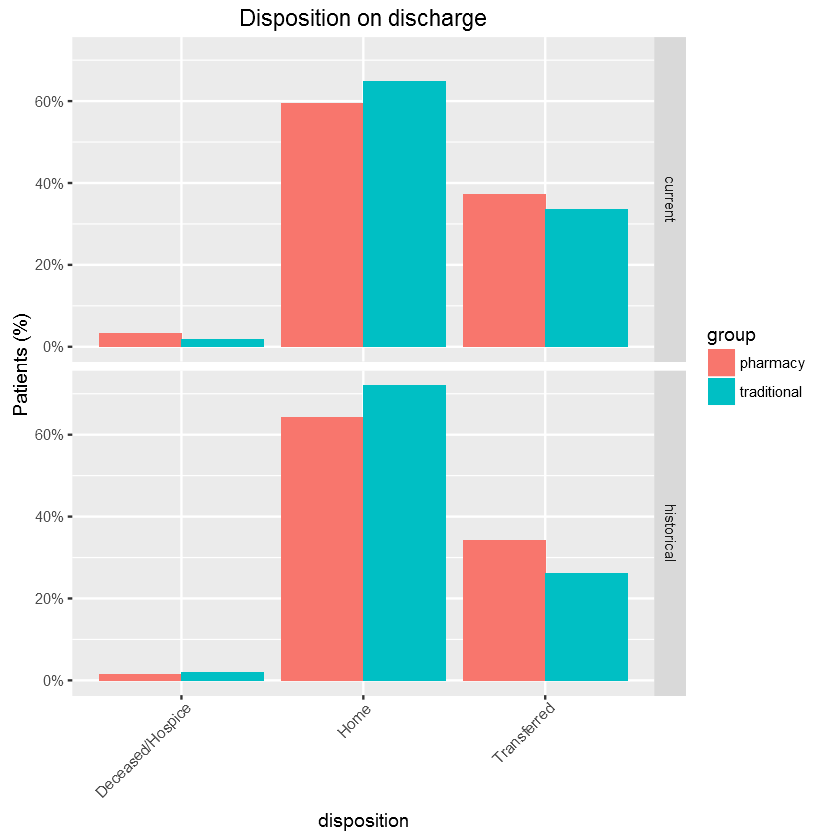

In [14]:
counts <- pts.include %>% 
    inner_join(data.demographics, by = "pie.id") %>%
    mutate(disposition = str_replace_all(disposition, regex(".*expired.*|.*hospice.*|.*deceased.*", ignore_case = TRUE), "Deceased/Hospice"),
           disposition = str_replace_all(disposition, regex(".*home.*|.*against.*", ignore_case = TRUE), "Home"),
           disposition = str_replace_all(disposition, regex(".*dc.*|.*transfer.*|.*care.*|.*skill.*", ignore_case = TRUE), "Transferred"),
           disposition = factor(disposition)) %>%
    group_by(group, year, disposition) %>%
    summarize(n = n()) %>%
    left_join(total, by = c("group", "year")) %>%
    mutate(perc = n / total) 
    
ggplot(data = counts, aes(x = disposition, fill = group)) +
    geom_bar(aes(y = perc), stat = "identity", position = "dodge") + 
    facet_grid(year ~ .) +
    ggtitle("Disposition on discharge") +
    ylab("Patients (%)") +
    scale_y_continuous(labels = percent) +
    theme(axis.text.x = element_text(angle = 45, hjust = 1))

## Exploratory Plots

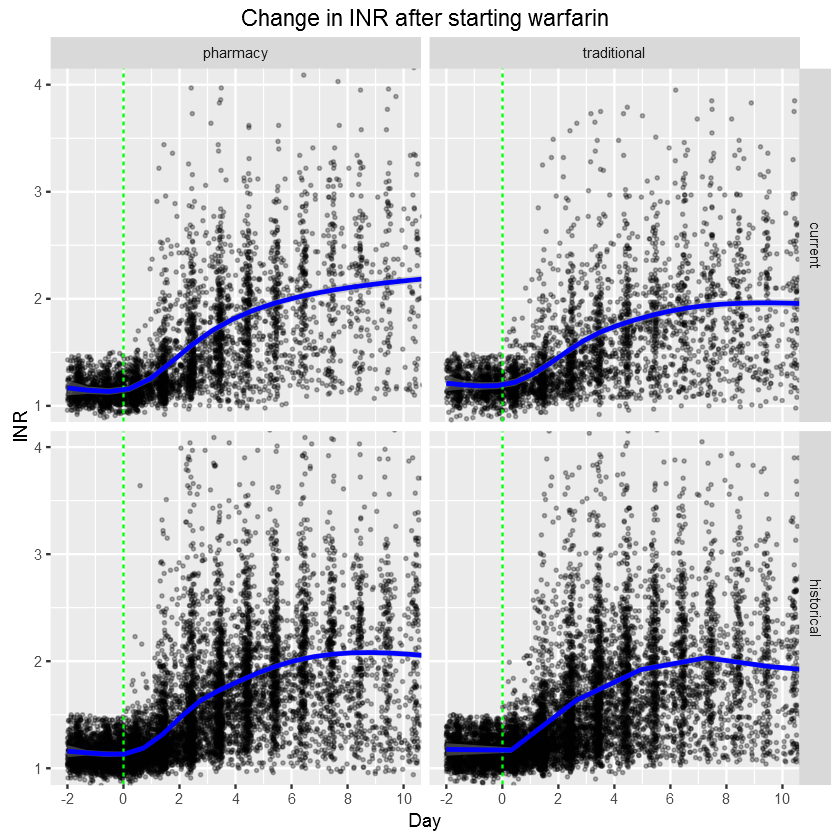

In [15]:
pts.include %>%
    inner_join(data.labs.inrs, by = "pie.id") %>%
    calc_lab_runtime(units = "days") %>%
    ggplot(aes(x = run.time, y = lab.result)) +
    facet_grid(year ~ group) +
    geom_point(alpha = 0.3, size = 0.5) +
    geom_vline(xintercept = 0, linetype = "dashed", color = "green") +
    geom_smooth(color = "blue") + 
    ggtitle("Change in INR after starting warfarin") +
    xlab("Day") +
    ylab("INR") +
    scale_x_continuous(breaks = seq(-2, 10, by = 2)) +
    coord_cartesian(xlim = c(-2, 10), ylim = c(1, 4)) 

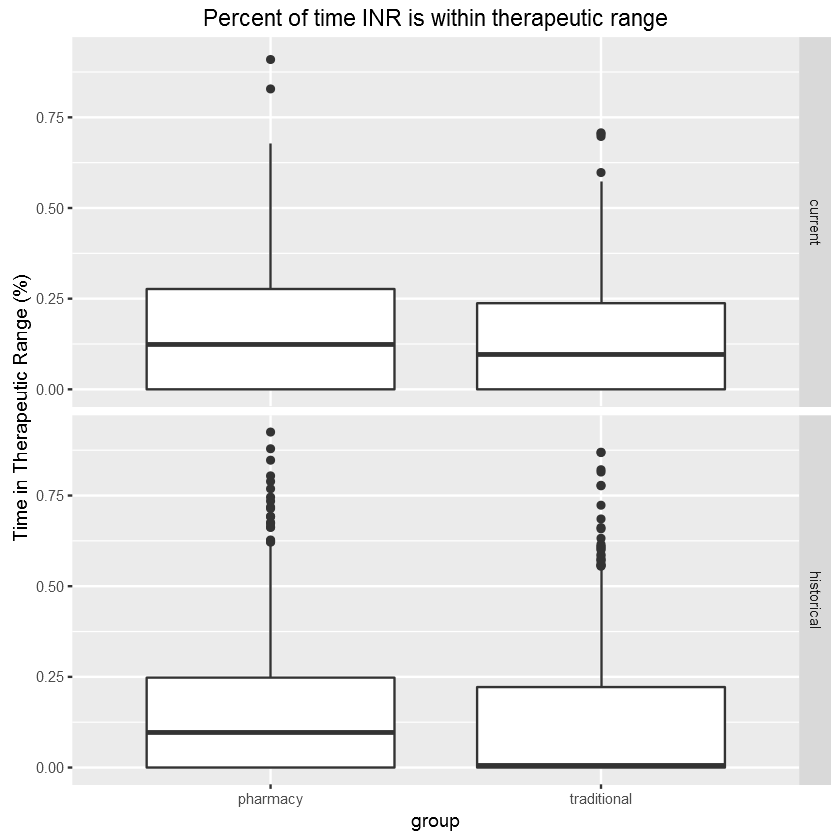

In [16]:
pts.include %>%
    inner_join(data.inr.inrange, by = "pie.id") %>%
    ggplot(aes(x = group, y = perc.time)) +
    geom_boxplot() +
    facet_grid(year ~ .) +
    ggtitle("Percent of time INR is within therapeutic range") +
    ylab("Time in Therapeutic Range (%)")

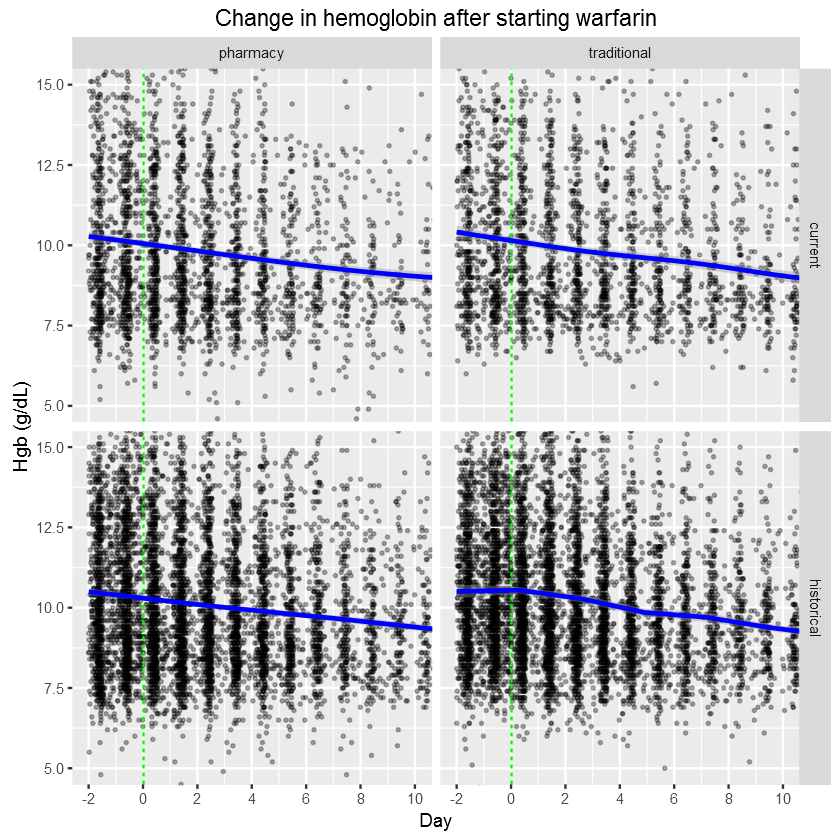

In [17]:
pts.include %>%
    inner_join(data.labs.hgb, by = "pie.id") %>%
    calc_lab_runtime(units = "days") %>%
    ggplot(aes(x = run.time, y = lab.result)) +
    facet_grid(year ~ group) +
    geom_point(alpha = 0.3, size = 0.5) +
    geom_vline(xintercept = 0, linetype = "dashed", color = "green") +
    geom_smooth(color = "blue") + 
    ggtitle("Change in hemoglobin after starting warfarin") +
    xlab("Day") +
    ylab("Hgb (g/dL)") +
    scale_x_continuous(breaks = seq(-2, 10, by = 2)) +
    coord_cartesian(xlim = c(-2, 10), ylim = c(5, 15)) 